In [21]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter, ImageEnhance
from scipy.ndimage import gaussian_filter, sobel
from scipy.fft import fft2
import pywt
from skimage.filters import threshold_otsu

Successfully loaded 15 images.


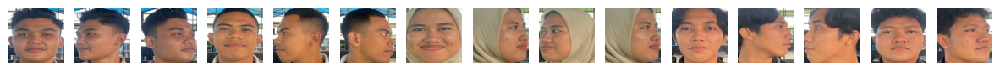

In [3]:
def load_images_from_folder(folder_path, target_size=(256, 256), max_images=15):
    # List untuk menyimpan gambar dalam bentuk array
    image_arrays = []
    
    # Mendapatkan semua file gambar dari folder dan subfolder
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
                try:
                    image_path = os.path.join(root, file)
                    image = Image.open(image_path).resize(target_size)
                    image_array = np.array(image)
                    image_arrays.append(image_array)
                    
                    # Berhenti jika sudah mencapai batas max_images
                    if len(image_arrays) >= max_images:
                        return image_arrays
                except Exception as e:
                    print(f"Failed to process {file}: {e}")
    
    return image_arrays

# Path ke folder yang berisi gambar-gambar
folder_path = 'Data2'

# Memuat gambar dari folder dan subfolder
image_arrays = load_images_from_folder(folder_path)


# Memeriksa apakah ada gambar yang berhasil dimuat
if image_arrays:
    # Mengubah list menjadi array numpy 4D
    images_stack = np.stack(image_arrays, axis=0)
    print(f"Successfully loaded {len(image_arrays)} images.")
    
    # Menampilkan gambar-gambar yang telah dimuat
    fig, axes = plt.subplots(1, len(image_arrays), figsize=(15, 15))
    for ax, img in zip(axes, image_arrays):
        ax.imshow(img)
        ax.axis('off')
    plt.show()
else:
    print("No images were loaded.")

Successfully loaded 15 images.


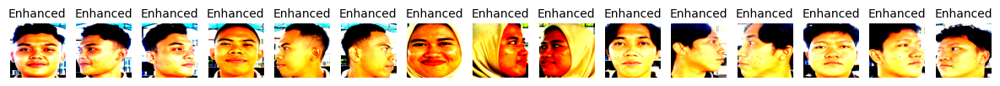

In [15]:
def load_images_from_folder(folder_path, target_size=(256, 256), max_images=15):
    image_arrays = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
                try:
                    image_path = os.path.join(root, file)
                    image = Image.open(image_path).resize(target_size)
                    image_array = np.array(image)
                    image_arrays.append(image_array)
                    if len(image_arrays) >= max_images:
                        return image_arrays
                except Exception as e:
                    print(f"Failed to process {file}: {e}")
    return image_arrays

def enhance_image(image_array):
    # Convert array back to PIL image for processing
    image = Image.fromarray(image_array)
    
    # Noise reduction using Gaussian filter
    image_gaussian = image.filter(ImageFilter.GaussianBlur(radius=1))
    
    # Convert back to numpy array
    image_gaussian_array = np.array(image_gaussian)
    
    # Histogram equalization using numpy
    image_hist_eq = exposure_equalize_hist(image_gaussian_array)
    
    # Convert back to PIL image for further enhancements
    image_hist_eq_pil = Image.fromarray(np.uint8(image_hist_eq * 255))
    
    # Enhance contrast
    enhancer = ImageEnhance.Contrast(image_hist_eq_pil)
    image_contrast = enhancer.enhance(2)  # Increase contrast by a factor of 2
    
    # Enhance brightness
    enhancer = ImageEnhance.Brightness(image_contrast)
    image_brightness = enhancer.enhance(1.2)  # Increase brightness by a factor of 1.2
    
    # Convert back to numpy array
    enhanced_image_array = np.array(image_brightness)
    
    return enhanced_image_array

def exposure_equalize_hist(image_array):
    # Convert to float to avoid clipping values
    img_float = image_array.astype(np.float64) / 255.0
    # Compute histogram
    hist, bins = np.histogram(img_float.flatten(), bins=256, range=[0, 1])
    # Compute cumulative distribution function (CDF)
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    # Use linear interpolation of CDF to find new pixel values
    cdf_normalized = np.ma.masked_equal(cdf_normalized, 0)
    cdf_normalized = (cdf_normalized - cdf_normalized.min()) * 255 / (cdf_normalized.max() - cdf_normalized.min())
    cdf_normalized = np.ma.filled(cdf_normalized, 0).astype('uint8')
    image_equalized = cdf_normalized[(img_float * 255).astype('uint8')]
    return image_equalized.astype(np.float64) / 255.0

# Path ke folder yang berisi gambar-gambar
folder_path = 'Data2'

# Memuat gambar dari folder dan subfolder
image_arrays = load_images_from_folder(folder_path)

# Memeriksa apakah ada gambar yang berhasil dimuat
if image_arrays:
    print(f"Successfully loaded {len(image_arrays)} images.")
    
    # Pre-process and enhance each image
    enhanced_images = [enhance_image(image) for image in image_arrays]
    
    # Menampilkan gambar-gambar yang telah di-enhance
    fig, axes = plt.subplots(1, len(enhanced_images), figsize=(15, 5))
    for i, enhanced in enumerate(enhanced_images):
        axes[i].imshow(enhanced)
        axes[i].axis('off')
        axes[i].set_title("Enhanced",fontsize=10, pad=5)
    
    plt.show()
else:
    print("No images were loaded.")


Successfully loaded 15 images.


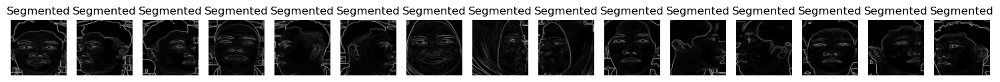

In [17]:
def load_images_from_folder(folder_path, target_size=(256, 256), max_images=15):
    image_arrays = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
                try:
                    image_path = os.path.join(root, file)
                    image = Image.open(image_path).resize(target_size)
                    image_array = np.array(image)
                    image_arrays.append(image_array)
                    if len(image_arrays) >= max_images:
                        return image_arrays
                except Exception as e:
                    print(f"Failed to process {file}: {e}")
    return image_arrays

def enhance_image(image_array):
    image = Image.fromarray(image_array)
    image_gaussian = image.filter(ImageFilter.GaussianBlur(radius=1))
    image_gaussian_array = np.array(image_gaussian)
    image_hist_eq = exposure_equalize_hist(image_gaussian_array)
    image_hist_eq_pil = Image.fromarray(np.uint8(image_hist_eq * 255))
    enhancer = ImageEnhance.Contrast(image_hist_eq_pil)
    image_contrast = enhancer.enhance(2)
    enhancer = ImageEnhance.Brightness(image_contrast)
    image_brightness = enhancer.enhance(1.2)
    enhanced_image_array = np.array(image_brightness)
    return enhanced_image_array

def exposure_equalize_hist(image_array):
    img_float = image_array.astype(np.float64) / 255.0
    hist, bins = np.histogram(img_float.flatten(), bins=256, range=[0, 1])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    cdf_normalized = np.ma.masked_equal(cdf_normalized, 0)
    cdf_normalized = (cdf_normalized - cdf_normalized.min()) * 255 / (cdf_normalized.max() - cdf_normalized.min())
    cdf_normalized = np.ma.filled(cdf_normalized, 0).astype('uint8')
    image_equalized = cdf_normalized[(img_float * 255).astype('uint8')]
    return image_equalized.astype(np.float64) / 255.0

def detect_edges(image_array):
    # Convert image to grayscale if it's not already
    if len(image_array.shape) == 3 and image_array.shape[2] == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    
    # Apply Sobel filter
    sobel_x = sobel(image_array, axis=0)
    sobel_y = sobel(image_array, axis=1)
    edge_magnitude = np.hypot(sobel_x, sobel_y)
    
    # Normalize to range [0, 255]
    edge_magnitude = (edge_magnitude / edge_magnitude.max()) * 255
    return edge_magnitude.astype(np.uint8)

# Path ke folder yang berisi gambar-gambar
folder_path = 'Data2'

# Memuat gambar dari folder dan subfolder
image_arrays = load_images_from_folder(folder_path)

# Memeriksa apakah ada gambar yang berhasil dimuat
if image_arrays:
    print(f"Successfully loaded {len(image_arrays)} images.")
    
    # Pre-process and enhance each image
    enhanced_images = [enhance_image(image) for image in image_arrays]
    
    # Segment each image using edge detection
    segmented_images = [detect_edges(image) for image in enhanced_images]
    
    # Menampilkan gambar-gambar yang telah disegmentasi
    fig, axes = plt.subplots(1, len(segmented_images), figsize=(15, 5))
    for i, segmented in enumerate(segmented_images):
        axes[i].imshow(segmented, cmap='gray')
        axes[i].axis('off')
        axes[i].set_title("Segmented")
    
    plt.tight_layout()
    plt.show()
else:
    print("No images were loaded.")


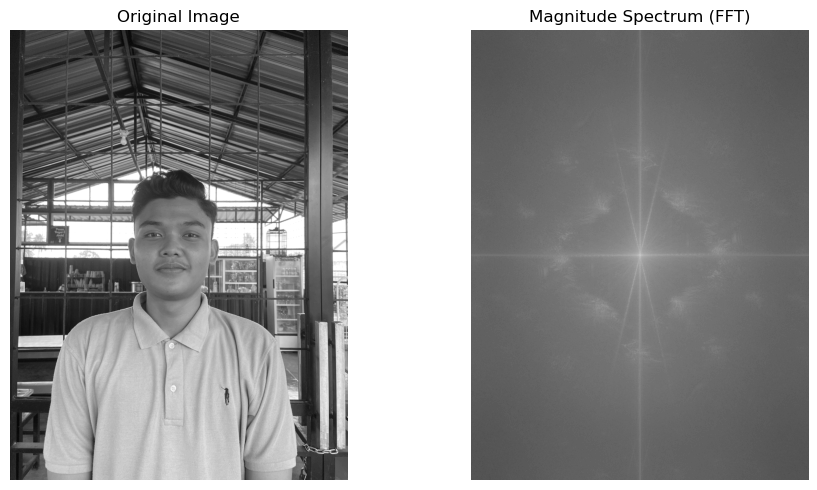

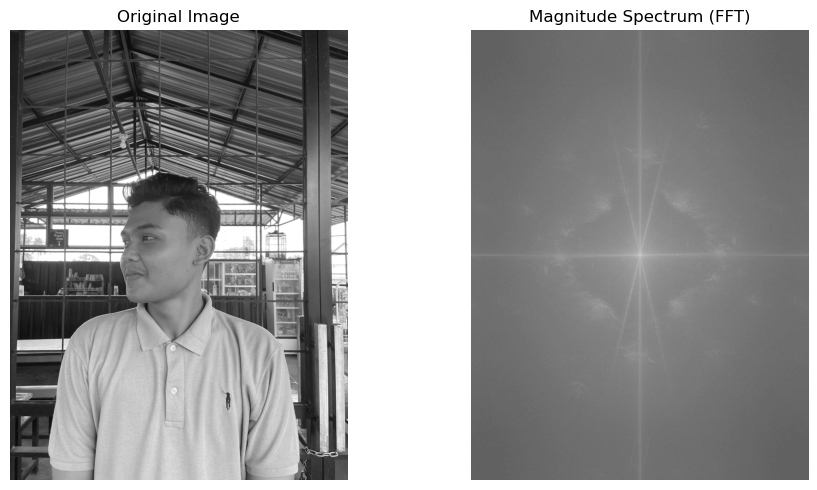

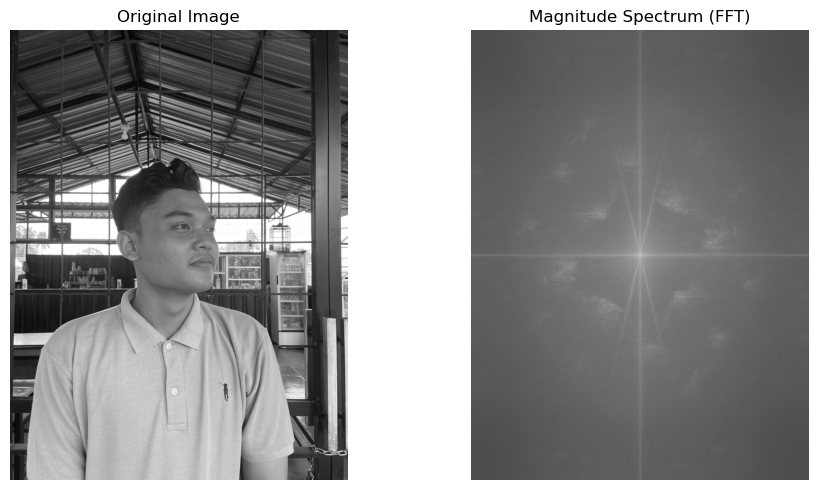

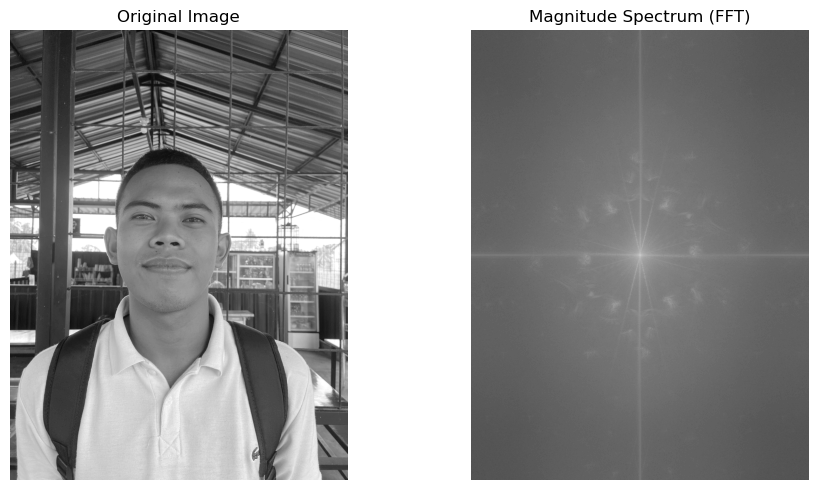

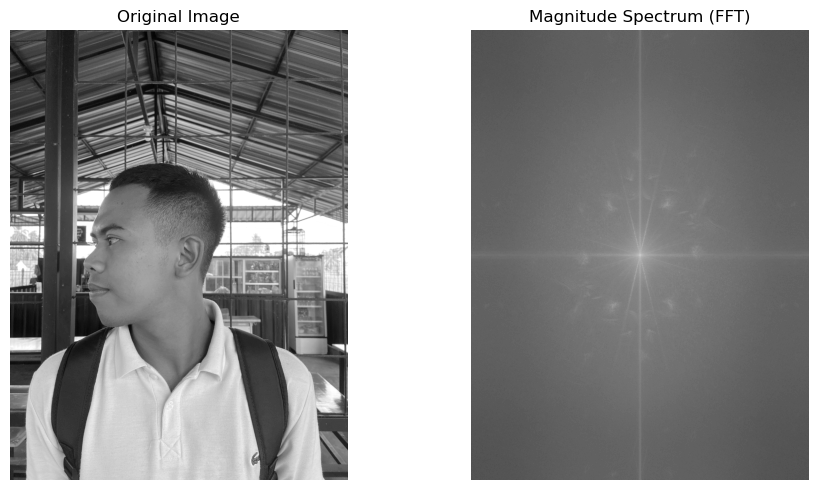

...

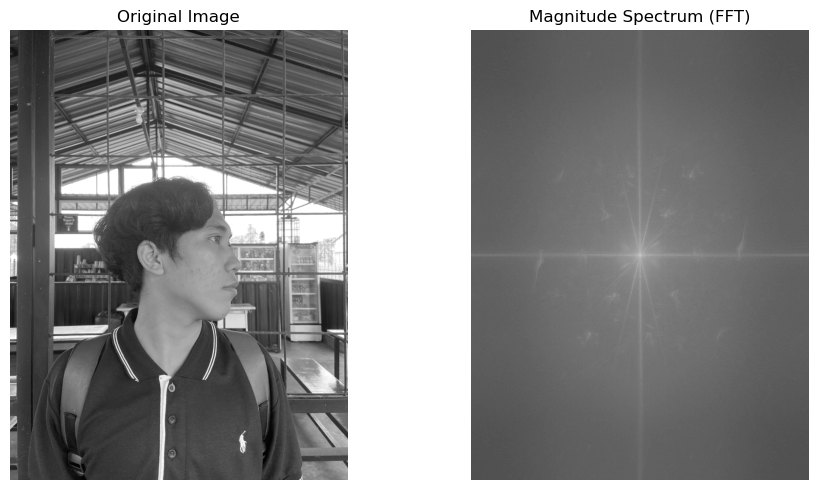

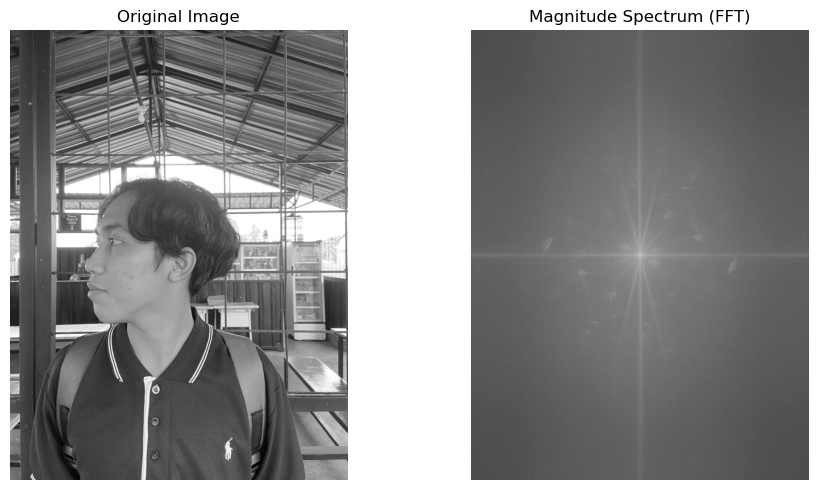

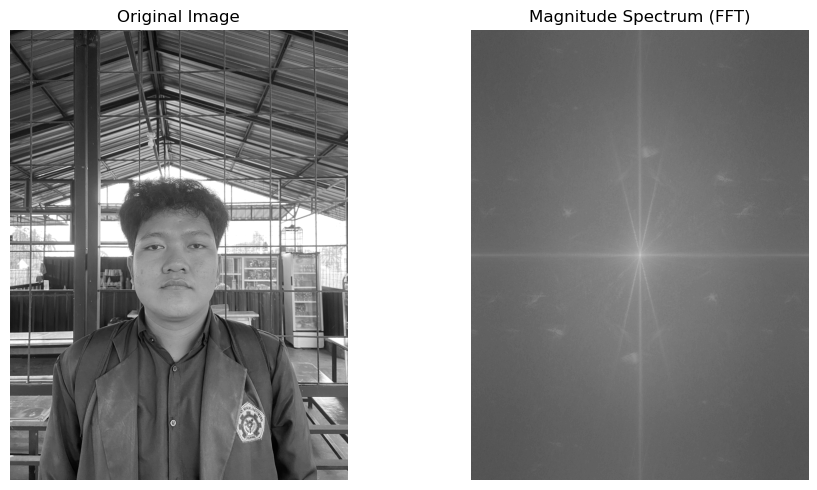

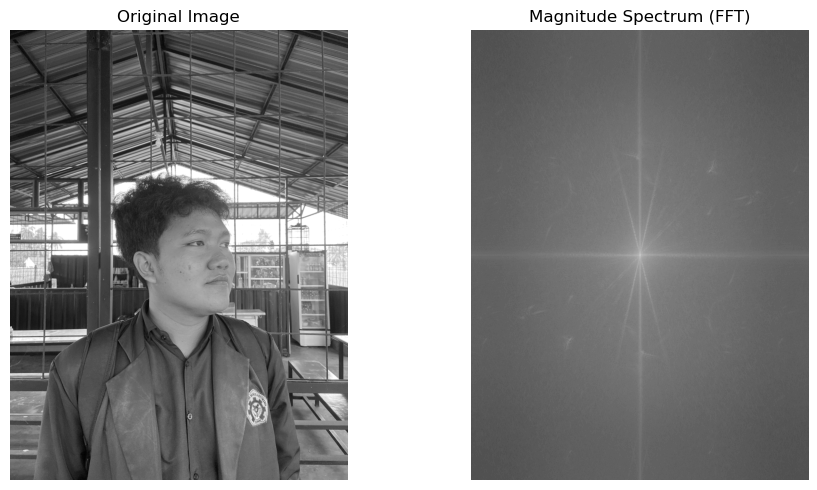

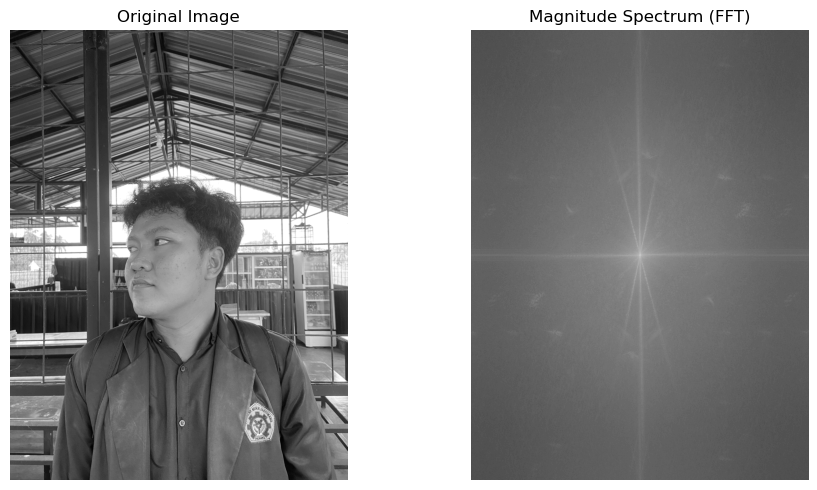

In [22]:
def process_images_in_directory(directory):
    for root, _, files in os.walk(directory):
        for file in files:
            if file.endswith('.jpg') or file.endswith('.png'):
                image_path = os.path.join(root, file)
                process_image(image_path)

def process_image(image_path):
    # Baca citra menggunakan PIL
    img = Image.open(image_path).convert('L')  # Ubah ke grayscale jika diperlukan
    
    # Konversi ke numpy array
    img_array = np.array(img)
    
    # Lakukan FFT
    fft_result = np.fft.fft2(img_array)
    fft_shifted = np.fft.fftshift(fft_result)
    magnitude_spectrum = 20 * np.log(np.abs(fft_shifted))
    
    # Tampilkan citra asli dan hasil FFT
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    
    axs[0].imshow(img, cmap='gray')
    axs[0].axis('off')
    axs[0].set_title('Original Image')
    
    axs[1].imshow(magnitude_spectrum, cmap='gray')
    axs[1].axis('off')
    axs[1].set_title('Magnitude Spectrum (FFT)')
    
    plt.tight_layout()
    plt.show()
    
    # Simpan hasil FFT jika perlu
    # fft_image = Image.fromarray(magnitude_spectrum.astype(np.uint8))
    # fft_image.save(image_path.replace('.jpg', '_fft.jpg').replace('.png', '_fft.png'))
    # print(f"Processed: {image_path}")

# Ganti dengan path folder yang ingin Anda proses
folder_path = 'Data'

# Proses citra dalam folder dan subfolder
process_images_in_directory(folder_path)


Successfully loaded 15 images.
Color Histogram: [38, 35, 35, 31, 31, 26, 17, 24, 59, 77]
Hough Transform Angles: [ 0.78539816  0.78539816  0.78539816 -0.78539816 -0.78539816 -0.78539816
 -0.78539816  0.78539816 -0.78539816 -1.57079633 -1.57079633 -1.57079633
  0.         -1.51843645  0.78539816 -0.59341195 -0.95993109 -0.01745329
 -1.50098316  1.53588974  1.13446401 -1.04719755  1.30899694 -0.99483767
 -1.55334303  0.55850536  0.41887902  1.15191731 -0.61086524 -1.57079633
 -0.4712389  -1.32645023 -1.29154365 -1.30899694 -0.27925268 -1.57079633
 -1.53588974 -1.44862328  1.22173048  1.46607657  1.37881011  0.10471976
 -1.30899694  1.15191731  1.32645023  0.45378561  1.1693706   0.26179939
 -1.22173048  1.1693706  -1.22173048 -0.03490659 -0.27925268 -0.43633231
 -0.99483767  0.08726646 -0.43633231  0.         -0.26179939  0.06981317
 -1.48352986 -1.44862328 -1.55334303 -0.27925268  0.78539816 -0.78539816
  1.53588974  0.78539816 -0.03490659  0.          0.01745329 -1.22173048
  0.7853981

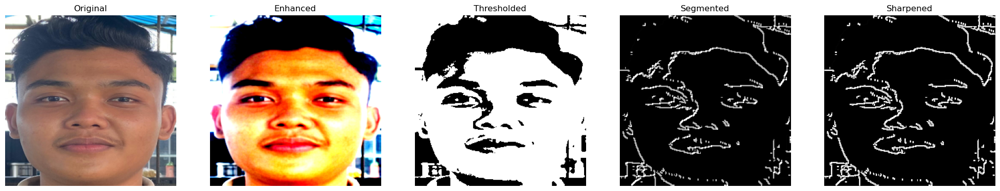

Color Histogram: [66, 72, 127, 169, 195, 171, 121, 94, 86, 93]
Hough Transform Angles: [ 0.78539816 -0.78539816 -0.78539816  0.78539816  0.78539816 -0.78539816
 -0.78539816 -1.55334303 -1.57079633 -1.57079633  1.53588974 -0.78539816
 -1.57079633 -1.36135682  0.33161256  1.09955743  1.3962634  -0.08726646
  1.01229097  0.         -0.01745329  1.37881011 -1.1693706  -0.97738438
 -1.04719755 -1.13446401 -1.30899694  0.19198622  1.34390352 -0.55850536
 -1.18682389 -1.57079633  0.01745329  0.13962634 -0.12217305 -0.41887902
 -0.29670597 -0.57595865 -0.87266463  0.29670597  0.34906585 -1.27409035
  1.29154365 -0.45378561  1.53588974 -0.54105207  1.48352986 -0.40142573
 -0.33161256 -0.48869219 -1.09955743  0.78539816  0.05235988 -0.78539816
 -1.27409035  0.33161256 -0.15707963 -1.11701072 -1.29154365  0.54105207
 -0.08726646 -1.29154365 -0.29670597  1.32645023 -0.2443461   0.78539816
  0.33161256 -0.33161256 -1.57079633  1.23918377  1.3962634  -1.51843645
  0.2268928   0.15707963 -1.57079633 

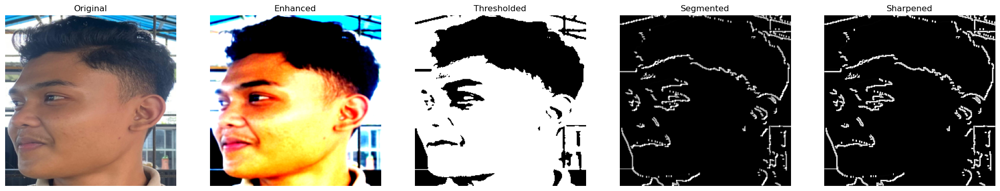

Color Histogram: [103, 163, 157, 97, 82, 88, 114, 109, 115, 115]
Hough Transform Angles: [-0.78539816  0.78539816 -0.78539816  0.78539816  0.78539816  0.78539816
  1.55334303 -0.78539816 -0.78539816  0.         -0.78539816 -0.78539816
  0.78539816  0.03490659  0.78539816 -1.46607657  1.18682389  1.55334303
  0.50614548  1.15191731  1.55334303 -0.9424778   1.23918377 -0.45378561
 -1.34390352  0.78539816  1.13446401 -1.55334303  1.06465084  0.4712389
 -0.78539816  1.25663706 -0.08726646  1.50098316 -1.57079633  1.09955743
  0.19198622 -1.06465084 -1.51843645  0.01745329  1.29154365  1.41371669
 -1.02974426  0.33161256  0.06981317  0.12217305  0.         -0.29670597
  0.48869219  0.26179939 -0.45378561 -1.41371669  0.48869219  1.51843645
 -0.17453293 -0.31415927 -1.44862328  1.3962634   0.         -0.33161256
  0.03490659 -0.50614548 -0.52359878  0.13962634 -0.17453293 -1.09955743
 -1.27409035 -0.05235988 -0.38397244 -1.23918377  1.55334303 -0.20943951
  1.43116999 -0.17453293 -0.41887902

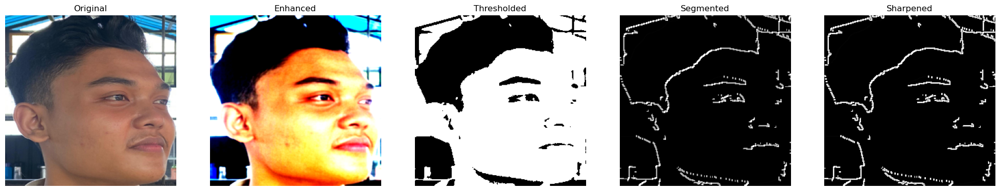

Color Histogram: [73, 112, 58, 51, 43, 65, 76, 94, 96, 91]
Hough Transform Angles: [-0.78539816  0.78539816 -0.78539816 -0.78539816 -1.57079633 -0.01745329
  0.78539816 -1.57079633 -0.78539816  0.78539816  0.78539816 -0.78539816
  0.         -1.55334303 -0.78539816  0.78539816  1.55334303  0.78539816
 -1.53588974 -1.36135682 -0.03490659 -1.46607657  0.78539816  1.51843645
 -1.34390352  0.78539816 -0.33161256  0.99483767 -1.57079633  1.3962634
 -0.19198622  1.53588974 -0.41887902 -0.99483767  1.41371669 -0.57595865
 -0.05235988 -1.29154365  0.40142573  1.51843645 -1.11701072  1.06465084
 -0.4712389  -0.99483767  1.29154365  1.43116999 -1.57079633  0.2443461
  0.34906585  0.41887902  0.12217305 -0.12217305  0.15707963  1.20427718
 -0.17453293 -1.30899694  1.34390352 -0.41887902 -1.57079633 -0.20943951
 -0.2443461   1.55334303  1.22173048  1.55334303  0.13962634 -1.55334303
  0.2268928   0.45378561 -0.38397244 -0.33161256  0.78539816 -0.12217305
 -0.26179939  0.01745329 -1.48352986  0.785

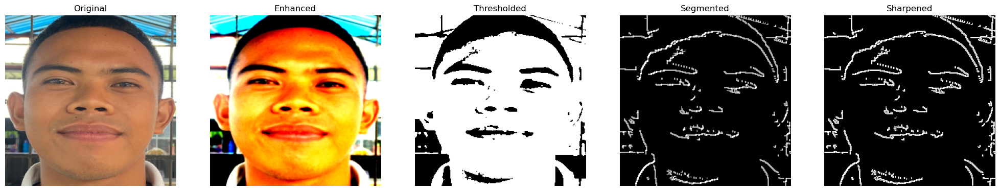

Color Histogram: [17, 14, 13, 19, 12, 17, 8, 13, 19, 13]
Hough Transform Angles: [ 0.78539816 -0.78539816 -0.78539816 -0.78539816 -0.78539816 -0.78539816
 -1.57079633 -1.57079633  0.31415927 -1.01229097 -0.26179939 -0.03490659
  1.55334303  0.4712389   1.02974426  0.78539816  0.         -0.97738438
  0.78539816  0.54105207 -1.55334303 -0.01745329 -0.4712389  -0.33161256
  0.2268928   0.          1.53588974 -0.33161256  1.53588974  0.78539816
 -1.02974426 -1.22173048 -1.32645023 -1.57079633  0.03490659  0.15707963
  1.15191731 -0.78539816  0.43633231  1.30899694 -1.04719755 -0.97738438
  1.15191731 -0.55850536  1.44862328 -1.27409035 -0.78539816  0.06981317
  1.25663706  1.41371669  1.43116999 -0.13962634 -1.01229097 -1.15191731
  1.53588974  0.78539816 -1.36135682  0.41887902 -1.01229097  0.99483767
  1.55334303  1.32645023  1.43116999  0.78539816  0.08726646  1.15191731
  0.10471976]
FFT Features (first 10x10): [[7.89923818e+06 3.22001530e+05 2.94656466e+05 2.03608783e+05
  9.31139126

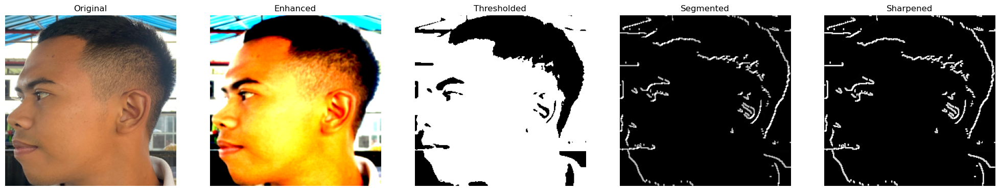

Color Histogram: [25, 69, 178, 262, 342, 338, 351, 312, 253, 214]
Hough Transform Angles: [-0.78539816 -0.78539816 -0.78539816  0.78539816 -0.78539816  0.78539816
 -0.52359878 -0.9424778   1.04719755  1.55334303 -1.46607657 -0.78539816
 -0.55850536 -0.99483767 -1.55334303  1.01229097  0.01745329  0.13962634
  1.41371669 -0.48869219  0.78539816  0.52359878  0.27925268  0.78539816
 -1.1693706   0.08726646  1.48352986 -0.34906585  1.53588974  1.22173048
 -0.17453293 -0.20943951  1.50098316  1.55334303 -0.17453293  0.01745329
  0.36651914  0.45378561 -0.20943951 -1.25663706 -1.09955743 -0.17453293
 -1.34390352 -1.34390352  1.09955743  1.11701072  0.05235988 -0.99483767
 -1.46607657 -0.03490659  1.50098316  0.48869219  1.22173048  0.27925268
  0.03490659 -0.01745329  1.25663706  0.19198622 -0.10471976 -1.09955743
 -1.55334303 -0.13962634 -1.46607657 -0.06981317 -1.29154365  1.20427718
 -1.18682389 -1.36135682 -1.44862328  1.55334303  1.53588974  0.78539816
  0.78539816 -1.53588974]
FFT Feat

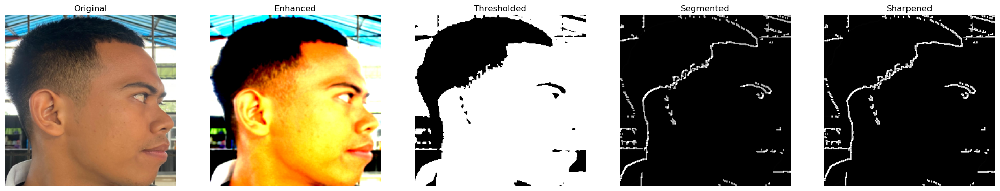

Color Histogram: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Hough Transform Angles: [-0.78539816  0.78539816  0.78539816 -0.78539816  0.78539816  0.78539816
  0.78539816 -0.78539816  0.78539816  0.78539816 -1.01229097  0.97738438
  1.55334303  0.4712389  -0.78539816  0.01745329 -0.48869219 -0.48869219
 -1.36135682 -1.53588974  0.         -1.32645023  1.3962634  -1.29154365
 -1.41371669 -1.50098316  1.25663706 -0.43633231  1.44862328  1.13446401
  1.43116999  1.53588974  0.17453293  1.53588974 -1.34390352  1.46607657
  1.22173048 -1.30899694 -0.78539816 -1.29154365  0.43633231  1.25663706
  1.27409035 -0.38397244 -1.13446401 -1.46607657 -1.13446401 -0.2268928
  1.51843645 -0.38397244 -1.04719755 -0.05235988 -0.17453293  0.06981317
 -0.45378561 -1.57079633  1.22173048  1.48352986 -0.34906585  0.03490659
 -0.40142573  0.2268928   1.46607657 -1.34390352 -1.48352986 -0.27925268
 -0.10471976 -0.10471976  0.17453293  0.08726646 -0.05235988  0.08726646
 -0.19198622  0.05235988  0.78539816 -0.55850536 -0.7

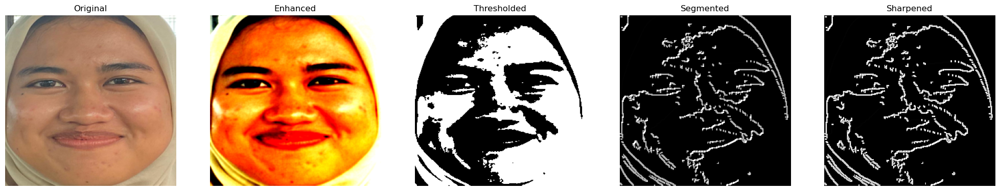

Color Histogram: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Hough Transform Angles: [-0.78539816 -0.78539816  0.78539816 -0.78539816 -0.48869219  0.78539816
  0.78539816 -0.78539816  0.78539816 -0.26179939 -0.29670597  0.15707963
 -0.78539816 -0.55850536  0.          0.78539816  0.59341195  1.50098316
 -1.55334303 -0.45378561 -0.95993109 -1.43116999  0.97738438 -1.48352986
 -0.17453293  1.48352986 -0.78539816  0.08726646  1.27409035 -0.15707963
 -1.41371669  0.01745329 -1.30899694  0.78539816  0.52359878 -0.05235988
  0.01745329  1.02974426 -0.06981317 -0.19198622 -1.50098316  0.99483767
 -0.52359878 -1.04719755 -1.08210414 -1.57079633  1.50098316 -0.43633231
  1.55334303 -1.46607657 -0.12217305  1.43116999 -1.20427718 -1.43116999
 -1.44862328  0.45378561  1.30899694  1.34390352  1.27409035  0.78539816
  0.          1.32645023  0.19198622  1.04719755  1.09955743  0.78539816
  0.08726646 -1.37881011  0.43633231  1.55334303 -0.31415927 -1.1693706
  0.17453293 -1.41371669  1.55334303  0.43633231 -1.3

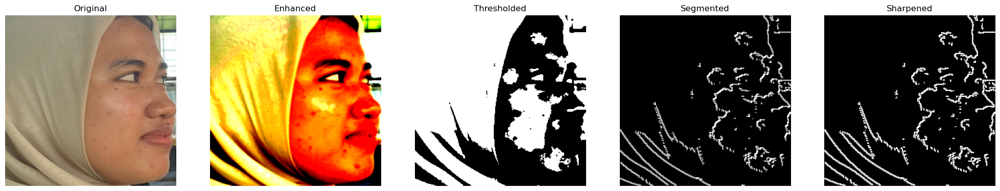

Color Histogram: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Hough Transform Angles: [ 0.78539816  0.         -0.78539816  0.78539816  0.78539816 -1.57079633
  0.78539816 -0.78539816 -0.78539816  0.33161256 -0.78539816 -0.78539816
 -0.78539816  0.57595865  0.52359878  0.78539816 -0.9250245   0.15707963
 -0.17453293  1.04719755  0.78539816  0.43633231  1.01229097 -0.15707963
 -0.36651914 -0.31415927 -0.31415927 -0.50614548 -1.06465084  1.11701072
  1.01229097  0.12217305 -0.29670597 -1.46607657 -0.01745329  1.32645023
 -1.30899694 -1.57079633  1.30899694 -0.06981317  0.78539816  0.05235988
  0.          1.43116999  1.41371669  1.46607657  1.36135682  1.51843645
 -1.32645023 -1.20427718  0.40142573 -1.51843645 -1.48352986  1.50098316
 -1.13446401 -1.57079633 -1.3962634   1.50098316  0.05235988 -1.22173048
 -1.41371669 -1.36135682 -1.20427718 -1.48352986  0.78539816  1.44862328
  1.22173048 -0.17453293 -1.44862328  1.32645023  1.37881011  0.78539816
 -0.78539816 -0.17453293 -1.51843645 -0.03490659  0.

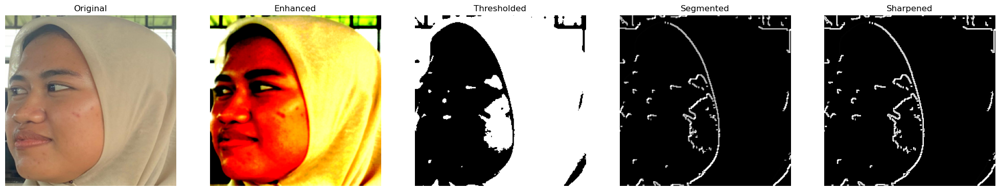

Color Histogram: [33, 38, 18, 6, 4, 17, 19, 16, 23, 22]
Hough Transform Angles: [ 0.78539816  0.78539816  0.78539816 -0.78539816 -0.78539816  0.78539816
 -0.78539816  0.          1.50098316 -1.01229097 -1.41371669  1.51843645
  1.55334303 -0.99483767 -0.2443461  -1.37881011 -0.08726646  0.78539816
  0.03490659 -0.78539816  0.78539816  1.1693706  -0.4712389  -0.54105207
 -0.57595865 -0.01745329 -1.51843645 -1.55334303  1.18682389  0.54105207
  1.01229097  0.40142573  1.30899694 -0.97738438 -1.25663706  0.19198622
  0.59341195 -0.2268928  -1.25663706 -1.57079633 -1.08210414 -1.46607657
 -0.4712389  -0.29670597 -1.11701072 -1.43116999 -1.36135682  1.15191731
 -1.32645023  1.48352986 -1.20427718 -0.2268928  -0.33161256  0.41887902
  0.13962634 -1.53588974 -0.17453293 -0.12217305 -0.27925268  1.53588974
  0.29670597  1.18682389 -0.19198622  1.23918377  1.53588974 -0.78539816
 -0.78539816  0.34906585  0.10471976  0.15707963  0.05235988 -0.05235988
  1.3962634  -0.38397244  0.78539816]
FFT Fe

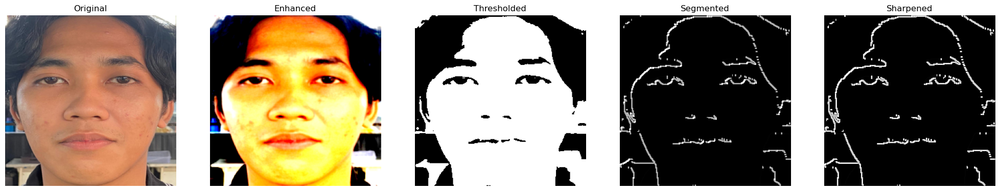

Color Histogram: [0, 0, 0, 0, 4, 1, 7, 19, 20, 34]
Hough Transform Angles: [-0.78539816 -0.78539816  0.78539816  0.78539816 -0.78539816  0.78539816
  0.78539816 -0.78539816 -1.57079633  1.55334303 -0.78539816 -1.55334303
 -0.78539816 -0.59341195  0.78539816  0.78539816  0.78539816 -1.55334303
  1.48352986  0.54105207  0.78539816 -0.55850536  1.3962634   1.08210414
 -1.51843645  0.59341195  1.53588974  0.41887902 -0.2268928  -1.23918377
  0.54105207 -0.17453293  0.33161256  0.78539816 -0.27925268  1.30899694
  1.44862328 -0.2443461  -1.36135682 -0.43633231 -1.20427718  0.
 -1.04719755 -1.13446401 -1.55334303  0.05235988  0.2268928  -1.55334303
  1.29154365  0.05235988  1.34390352 -0.01745329 -0.78539816 -1.53588974
  1.08210414  0.08726646  0.26179939 -1.46607657 -1.25663706 -1.37881011
 -1.57079633  0.31415927  1.22173048  0.2443461   1.04719755  0.
 -0.05235988 -1.32645023  0.4712389   1.53588974  1.20427718  0.78539816
 -0.78539816  1.1693706   0.38397244  0.19198622 -0.15707963 -0.0

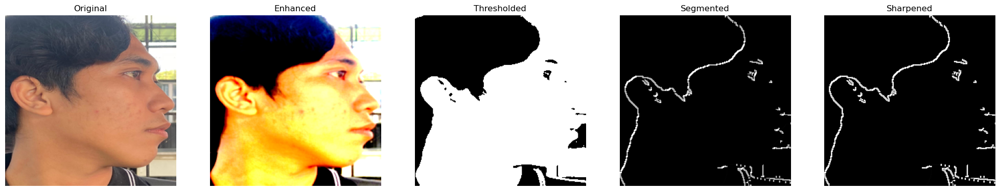

Color Histogram: [0, 0, 0, 0, 0, 0, 0, 0, 2, 2]
Hough Transform Angles: [ 0.78539816  0.78539816 -0.78539816 -0.78539816  0.78539816  0.78539816
 -0.78539816  0.50614548 -1.57079633  0.78539816 -0.78539816 -0.78539816
  0.55850536 -0.78539816 -1.57079633  0.78539816 -0.59341195 -0.57595865
 -1.57079633 -1.50098316 -0.45378561 -0.95993109 -1.53588974  0.2443461
  0.4712389  -1.15191731 -0.10471976  1.25663706 -0.31415927 -1.25663706
 -0.12217305 -0.26179939  0.          0.33161256  1.32645023  1.53588974
 -0.4712389  -1.20427718  0.05235988 -0.10471976 -0.50614548 -1.55334303
 -1.32645023 -1.50098316  1.32645023 -0.13962634  0.08726646 -0.10471976
  0.78539816  1.01229097  1.53588974 -0.97738438 -1.08210414  1.09955743
 -0.17453293  1.37881011  0.10471976 -1.29154365 -1.20427718 -1.23918377
  1.55334303  0.13962634  1.55334303 -1.09955743  0.4712389  -1.57079633
  1.29154365  0.03490659 -0.06981317 -0.19198622  1.46607657 -0.27925268
  0.03490659 -1.36135682  0.48869219  1.3962634  -1.4

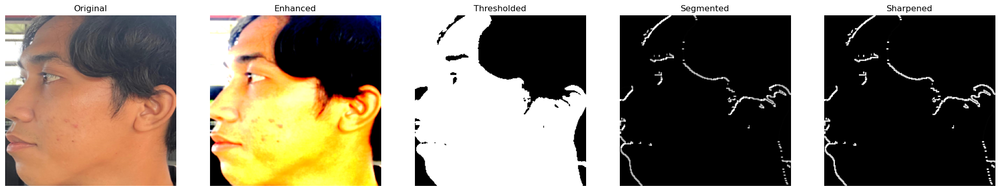

Color Histogram: [29, 56, 35, 16, 11, 12, 16, 20, 18, 15]
Hough Transform Angles: [ 0.78539816  0.78539816 -0.78539816 -0.78539816  0.78539816 -0.78539816
  0.78539816 -1.57079633  0.78539816 -0.78539816  0.78539816 -0.78539816
 -1.57079633  0.41887902  0.          0.48869219 -0.57595865 -0.01745329
  1.48352986  1.30899694 -0.48869219 -1.30899694 -1.34390352 -0.06981317
 -0.34906585  0.15707963 -1.13446401 -1.02974426  1.53588974 -0.41887902
  1.48352986 -1.27409035 -1.44862328 -1.34390352  1.23918377  1.50098316
 -0.78539816 -1.36135682  1.04719755  0.50614548  0.34906585  1.41371669
  1.51843645 -1.13446401 -1.1693706  -0.78539816 -1.53588974 -1.18682389
 -1.30899694  1.22173048 -0.13962634  0.27925268  1.46607657 -1.43116999
 -1.11701072 -0.06981317 -0.15707963  1.55334303  0.31415927 -0.05235988
  1.55334303 -0.26179939  1.09955743 -0.2268928  -0.31415927 -1.57079633
 -0.31415927  1.13446401  0.27925268  0.08726646 -0.59341195 -1.3962634
  0.78539816  0.2268928   0.27925268  0.   

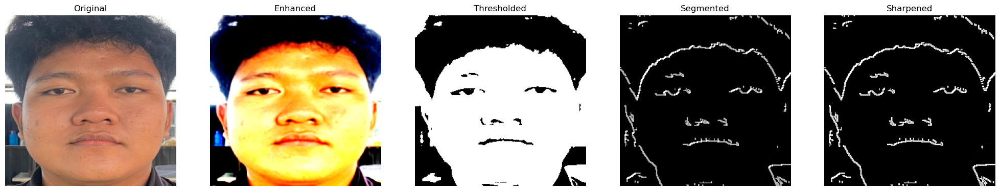

Color Histogram: [37, 49, 40, 21, 26, 11, 14, 14, 32, 19]
Hough Transform Angles: [ 0.78539816 -0.78539816 -0.78539816  0.78539816 -0.78539816  0.
 -0.78539816 -0.78539816  0.         -0.78539816  0.78539816  0.78539816
  1.22173048  0.06981317  0.01745329 -1.53588974  0.99483767  0.17453293
 -1.55334303  0.78539816  1.32645023  1.37881011 -1.01229097  0.27925268
  0.05235988  0.2268928  -0.03490659 -1.1693706   0.34906585 -0.78539816
 -0.2268928  -1.44862328 -1.08210414 -1.57079633  1.25663706  1.18682389
  0.17453293 -0.78539816  1.18682389 -0.08726646 -0.40142573 -1.13446401
 -1.29154365  1.25663706  1.09955743  0.54105207  0.78539816 -1.55334303
  0.50614548  0.12217305  1.50098316  1.29154365 -0.31415927 -1.30899694
  0.55850536 -0.26179939 -0.55850536 -0.55850536 -1.09955743 -1.50098316
 -1.57079633 -1.25663706  0.17453293  0.2443461  -0.50614548  1.43116999
 -0.27925268 -0.40142573 -0.45378561  0.78539816 -1.51843645 -0.29670597
  0.57595865 -0.08726646 -0.01745329  1.55334303 -

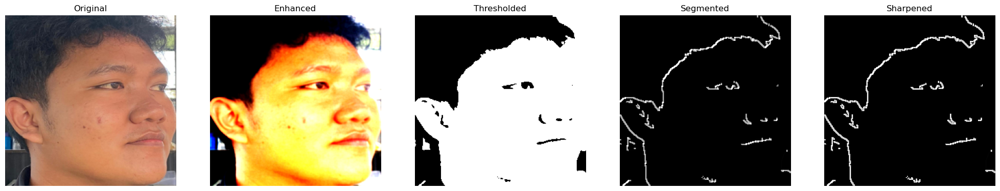

Color Histogram: [7, 10, 6, 5, 1, 1, 2, 1, 0, 1]
Hough Transform Angles: [-0.78539816  0.78539816 -0.78539816  0.78539816 -0.78539816 -0.78539816
  0.78539816 -1.48352986  0.         -0.78539816  0.78539816  0.78539816
 -0.78539816  0.52359878  1.1693706  -1.01229097 -1.13446401 -0.78539816
 -0.40142573 -1.53588974  0.          1.55334303 -0.55850536 -0.55850536
 -1.37881011  0.2268928   1.37881011 -0.08726646 -1.02974426 -1.25663706
 -1.57079633  1.36135682  1.25663706 -0.31415927  1.1693706   1.46607657
 -1.11701072 -1.3962634   1.50098316 -1.48352986 -1.43116999 -0.29670597
 -1.55334303 -1.09955743  0.52359878  1.55334303 -0.38397244 -0.45378561
  0.2268928  -0.57595865 -1.29154365  1.18682389  0.01745329  1.15191731
  0.43633231 -1.23918377  1.23918377  0.          1.55334303 -1.53588974
 -1.20427718 -1.57079633  0.40142573 -0.06981317 -1.53588974 -1.36135682
 -0.01745329  0.31415927  0.78539816 -0.78539816  0.01745329  0.12217305
  0.33161256  0.43633231  0.12217305  0.52359878  1

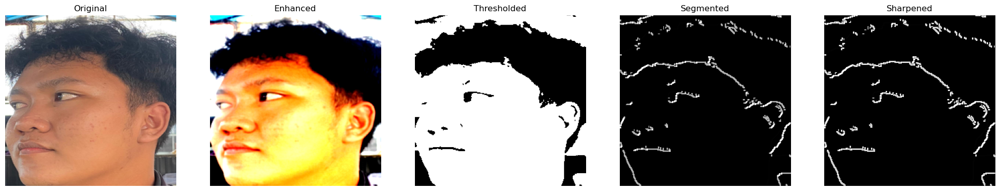

In [19]:
#akuisisi citra
def load_images_from_folder(folder_path, target_size=(256, 256), max_images=15):
    image_arrays = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
                try:
                    image_path = os.path.join(root, file)
                    image = Image.open(image_path).resize(target_size)
                    image_array = np.array(image)
                    image_arrays.append(image_array)
                    if len(image_arrays) >= max_images:
                        return image_arrays
                except Exception as e:
                    print(f"Failed to process {file}: {e}")
    return image_arrays

#pre-processing (image enhancement)
def enhance_image(image_array):
    image = Image.fromarray(image_array)
    image_gaussian = image.filter(ImageFilter.GaussianBlur(radius=1))
    image_gaussian_array = np.array(image_gaussian)
    image_hist_eq = exposure_equalize_hist(image_gaussian_array)
    image_hist_eq_pil = Image.fromarray(np.uint8(image_hist_eq * 255))
    enhancer = ImageEnhance.Contrast(image_hist_eq_pil)
    image_contrast = enhancer.enhance(2)
    enhancer = ImageEnhance.Brightness(image_contrast)
    image_brightness = enhancer.enhance(1.2)
    enhanced_image_array = np.array(image_brightness)
    return enhanced_image_array

def exposure_equalize_hist(image_array):
    img_float = image_array.astype(np.float64) / 255.0
    hist, bins = np.histogram(img_float.flatten(), bins=256, range=[0, 1])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    cdf_normalized = np.ma.masked_equal(cdf_normalized, 0)
    cdf_normalized = (cdf_normalized - cdf_normalized.min()) * 255 / (cdf_normalized.max() - cdf_normalized.min())
    cdf_normalized = np.ma.filled(cdf_normalized, 0).astype('uint8')
    image_equalized = cdf_normalized[(img_float * 255).astype('uint8')]
    return image_equalized.astype(np.float64) / 255.0

#segemntasi citra

def detect_edges(image_array):
    if len(image_array.shape) == 3 and image_array.shape[2] == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    
    sobel_x = sobel(image_array, axis=0)
    sobel_y = sobel(image_array, axis=1)
    edge_magnitude = np.hypot(sobel_x, sobel_y)
    
    edge_magnitude = (edge_magnitude / edge_magnitude.max()) * 255
    return edge_magnitude.astype(np.uint8)

#ekstraksi fitur
def sharpen_image(image_array):
    image = Image.fromarray(image_array)
    image_sharpened = image.filter(ImageFilter.SHARPEN)
    return np.array(image_sharpened)

def extract_color_histogram(image_array, bins=256):
    histogram = []
    for channel in range(3):
        hist, bin_edges = np.histogram(image_array[:, :, channel], bins=bins, range=(0, 256))
        histogram.extend(hist)
    return histogram

def extract_hough_transform(image_array):
    from skimage.feature import canny
    from skimage.transform import hough_line, hough_line_peaks
    
    if len(image_array.shape) == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    edges = canny(image_array)
    h, theta, d = hough_line(edges)
    accum, angles, dists = hough_line_peaks(h, theta, d)
    return accum, angles, dists

def extract_fft_features(image_array):
    if len(image_array.shape) == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    f_transform = fft2(image_array)
    f_transform_magnitude = np.abs(f_transform)
    return f_transform_magnitude

def extract_wavelet_features(image_array, wavelet='db1'):
    if len(image_array.shape) == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    coeffs = pywt.wavedec2(image_array, wavelet, level=2)
    
    features = []
    for coeff in coeffs:
        if isinstance(coeff, tuple):
            for sub_coeff in coeff:
                features.extend(sub_coeff.flatten())
        else:
            features.extend(coeff.flatten())
    
    return np.array(features)

#segmentasi citra (thresholding)
def apply_threshold(image_array):
    # Convert RGB image to grayscale
    grayscale_image = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    
    # Apply Otsu's thresholding
    threshold_value = threshold_otsu(grayscale_image)
    thresholded_image = grayscale_image > threshold_value
    
    # Convert thresholded image back to uint8 format
    thresholded_image = thresholded_image.astype(np.uint8) * 255
    
    return thresholded_image


# Path ke folder yang berisi gambar-gambar
folder_path = 'Data2'

# Memuat gambar dari folder dan subfolder
image_arrays = load_images_from_folder(folder_path)

# Memeriksa apakah ada gambar yang berhasil dimuat
if image_arrays:
    print(f"Successfully loaded {len(image_arrays)} images.")
    
    for image in image_arrays:
        # Pre-process and enhance the image
        enhanced_image = enhance_image(image)
        
        # Apply thresholding to the enhanced image
        thresholded_image = apply_threshold(enhanced_image)
        
        # Segment the image using edge detection
        segmented_image = detect_edges(thresholded_image)
        
        # Sharpen the segmented image to enhance edges
        sharpened_image = sharpen_image(segmented_image)
        
        # Extract features
        color_hist = extract_color_histogram(image)
        hough_accum, hough_angles, hough_dists = extract_hough_transform(image)
        fft_features = extract_fft_features(image)
        wavelet_features = extract_wavelet_features(image)
        
        print("Color Histogram:", color_hist[:10])
        print("Hough Transform Angles:", hough_angles)
        print("FFT Features (first 10x10):", fft_features[:10, :10])
        print("Wavelet Features (first 10):", wavelet_features[:10])
        
        # Menampilkan gambar yang telah dimuat, di-enhance, di-threshold, di-segmentasi, dan dipertajam
        fig, axes = plt.subplots(1, 5, figsize=(25, 5))
        
        axes[0].imshow(image)
        axes[0].axis('off')
        axes[0].set_title("Original")
        
        axes[1].imshow(enhanced_image)
        axes[1].axis('off')
        axes[1].set_title("Enhanced")
        
        axes[2].imshow(thresholded_image, cmap='gray')
        axes[2].axis('off')
        axes[2].set_title("Thresholded")
        
        axes[3].imshow(segmented_image, cmap='gray')
        axes[3].axis('off')
        axes[3].set_title("Segmented")
        
        axes[4].imshow(sharpened_image, cmap='gray')
        axes[4].axis('off')
        axes[4].set_title("Sharpened")
        
        plt.show()
else:
    print("No images were loaded from the specified folder.")


Successfully loaded 15 images.


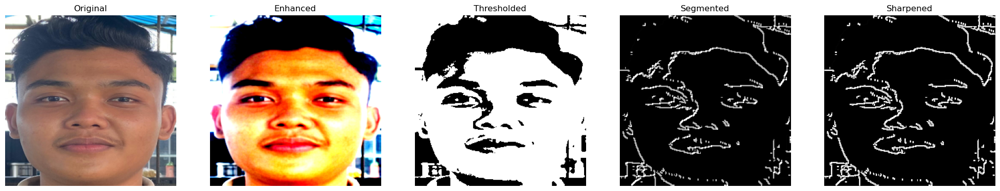

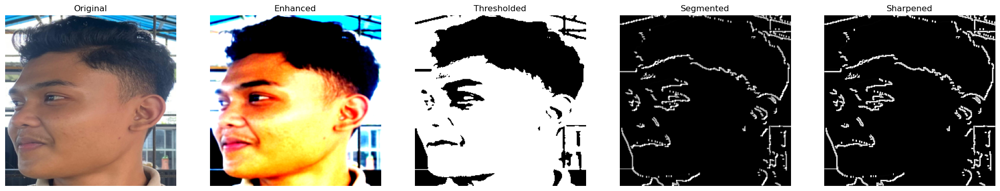

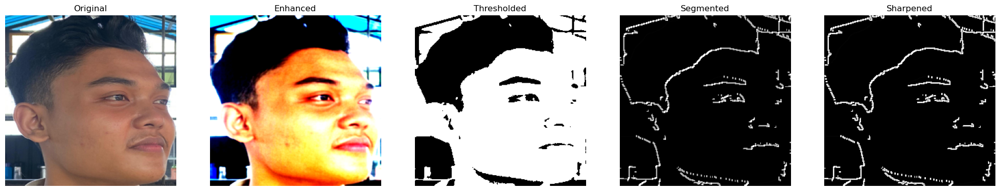

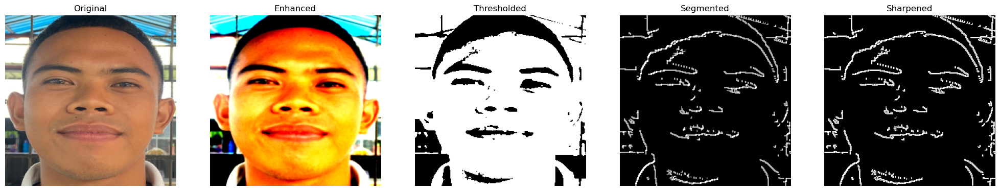

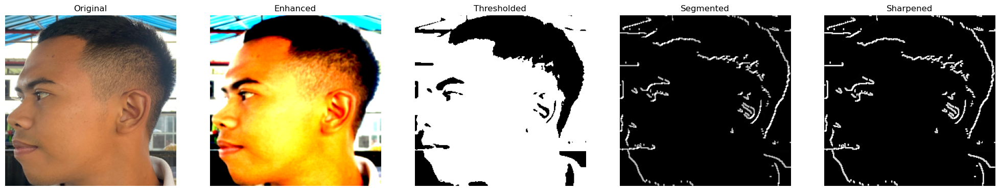

...

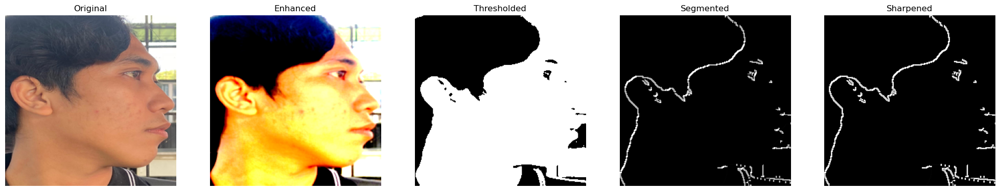

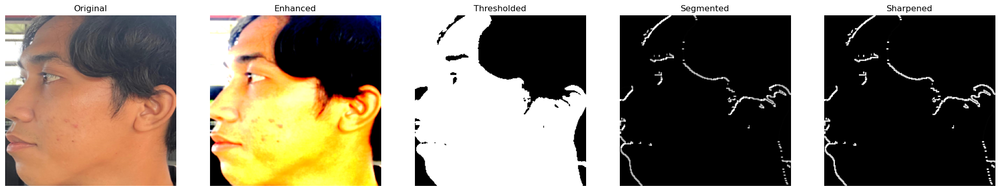

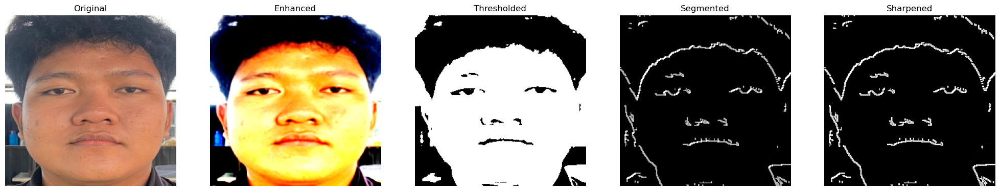

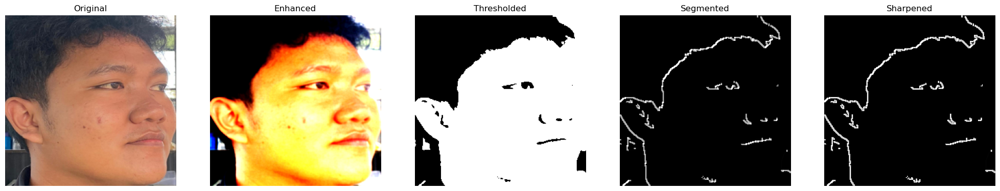

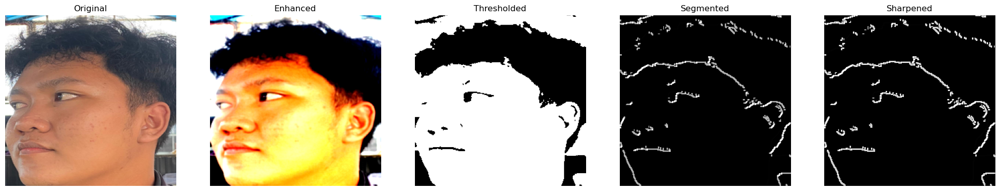

NameError: name 'pd' is not defined

In [20]:
def load_images_from_folder(folder_path, target_size=(256, 256), max_images=15):
    image_arrays = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
                try:
                    image_path = os.path.join(root, file)
                    image = Image.open(image_path).resize(target_size)
                    image_array = np.array(image)
                    image_arrays.append(image_array)
                    if len(image_arrays) >= max_images:
                        return image_arrays
                except Exception as e:
                    print(f"Failed to process {file}: {e}")
    return image_arrays

def enhance_image(image_array):
    image = Image.fromarray(image_array)
    image_gaussian = image.filter(ImageFilter.GaussianBlur(radius=1))
    image_gaussian_array = np.array(image_gaussian)
    image_hist_eq = exposure_equalize_hist(image_gaussian_array)
    image_hist_eq_pil = Image.fromarray(np.uint8(image_hist_eq * 255))
    enhancer = ImageEnhance.Contrast(image_hist_eq_pil)
    image_contrast = enhancer.enhance(2)
    enhancer = ImageEnhance.Brightness(image_contrast)
    image_brightness = enhancer.enhance(1.2)
    enhanced_image_array = np.array(image_brightness)
    return enhanced_image_array

def exposure_equalize_hist(image_array):
    img_float = image_array.astype(np.float64) / 255.0
    hist, bins = np.histogram(img_float.flatten(), bins=256, range=[0, 1])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    cdf_normalized = np.ma.masked_equal(cdf_normalized, 0)
    cdf_normalized = (cdf_normalized - cdf_normalized.min()) * 255 / (cdf_normalized.max() - cdf_normalized.min())
    cdf_normalized = np.ma.filled(cdf_normalized, 0).astype('uint8')
    image_equalized = cdf_normalized[(img_float * 255).astype('uint8')]
    return image_equalized.astype(np.float64) / 255.0

def detect_edges(image_array):
    if len(image_array.shape) == 3 and image_array.shape[2] == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    
    sobel_x = sobel(image_array, axis=0)
    sobel_y = sobel(image_array, axis=1)
    edge_magnitude = np.hypot(sobel_x, sobel_y)
    
    edge_magnitude = (edge_magnitude / edge_magnitude.max()) * 255
    return edge_magnitude.astype(np.uint8)

def sharpen_image(image_array):
    image = Image.fromarray(image_array)
    image_sharpened = image.filter(ImageFilter.SHARPEN)
    return np.array(image_sharpened)

def extract_color_histogram(image_array, bins=256):
    histogram = []
    for channel in range(3):
        hist, bin_edges = np.histogram(image_array[:, :, channel], bins=bins, range=(0, 256))
        histogram.extend(hist)
    return histogram

def extract_hough_transform(image_array):
    from skimage.feature import canny
    from skimage.transform import hough_line, hough_line_peaks
    
    if len(image_array.shape) == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    edges = canny(image_array)
    h, theta, d = hough_line(edges)
    accum, angles, dists = hough_line_peaks(h, theta, d)
    return accum, angles, dists

def extract_fft_features(image_array):
    if len(image_array.shape) == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    f_transform = fft2(image_array)
    f_transform_magnitude = np.abs(f_transform)
    return f_transform_magnitude

def extract_wavelet_features(image_array, wavelet='db1'):
    if len(image_array.shape) == 3:
        image_array = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    coeffs = pywt.wavedec2(image_array, wavelet, level=2)
    
    features = []
    for coeff in coeffs:
        if isinstance(coeff, tuple):
            for sub_coeff in coeff:
                features.extend(sub_coeff.flatten())
        else:
            features.extend(coeff.flatten())
    
    return np.array(features)

def apply_threshold(image_array):
    # Convert RGB image to grayscale
    grayscale_image = np.dot(image_array[...,:3], [0.2989, 0.5870, 0.1140])
    
    # Apply Otsu's thresholding
    threshold_value = threshold_otsu(grayscale_image)
    thresholded_image = grayscale_image > threshold_value
    
    # Convert thresholded image back to uint8 format
    thresholded_image = thresholded_image.astype(np.uint8) * 255
    
    return thresholded_image

# Path ke folder yang berisi gambar-gambar
folder_path = 'Data2'

# Memuat gambar dari folder dan subfolder
image_arrays = load_images_from_folder(folder_path)

# Memeriksa apakah ada gambar yang berhasil dimuat
if image_arrays:
    print(f"Successfully loaded {len(image_arrays)} images.")
    
    # List untuk menyimpan fitur dari setiap gambar
    features_list = []
    
    for image in image_arrays:
        # Pre-process and enhance the image
        enhanced_image = enhance_image(image)
        
        # Apply thresholding to the enhanced image
        thresholded_image = apply_threshold(enhanced_image)
        
        # Segment the image using edge detection
        segmented_image = detect_edges(thresholded_image)
        
        # Sharpen the segmented image to enhance edges
        sharpened_image = sharpen_image(segmented_image)
        
        # Extract features
        color_hist = extract_color_histogram(image)
        hough_accum, hough_angles, hough_dists = extract_hough_transform(image)
        fft_features = extract_fft_features(image)
        wavelet_features = extract_wavelet_features(image)
        
        # Concatenate all features into a single list
        all_features = np.concatenate([color_hist, hough_angles, fft_features.flatten(), wavelet_features])
        
        # Append the features to the list
        features_list.append(all_features)
        
        # Menampilkan gambar yang telah dimuat, di-enhance, di-threshold, di-segmentasi, dan dipertajam
        fig, axes = plt.subplots(1, 5, figsize=(25, 5))
        
        axes[0].imshow(image)
        axes[0].axis('off')
        axes[0].set_title("Original")
        
        axes[1].imshow(enhanced_image)
        axes[1].axis('off')
        axes[1].set_title("Enhanced")
        
        axes[2].imshow(thresholded_image, cmap='gray')
        axes[2].axis('off')
        axes[2].set_title("Thresholded")
        
        axes[3].imshow(segmented_image, cmap='gray')
        axes[3].axis('off')
        axes[3].set_title("Segmented")
        
        axes[4].imshow(sharpened_image, cmap='gray')
        axes[4].axis('off')
        axes[4].set_title("Sharpened")
        
        plt.show()
    
    # Mengonversi list fitur ke dalam DataFrame pandas
    df_features = pd.DataFrame(features_list)
    
    # Menyimpan DataFrame ke dalam file CSV
    csv_filename = 'image_features.csv'
    df_features.to_csv(csv_filename, index=False)
    
    print(f"Image features saved to {csv_filename}.")
else:
    print("No images were loaded from the specified folder.")


In [ ]:
import numpy as np
import pandas as pd
import cv2
from sklearn import svm
from sklearn.metrics import accuracy_score
from skimage.feature import graycomatrix, graycoprops
import os

# Function to load and split data
def load_data(training_data_path, testing_data_path):
    train = pd.read_csv(training_data_path)
    test = pd.read_csv(testing_data_path)
    return train, test

# Function to train the classifier
def train_classifier(train):
    columns = ['X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8']
    X_train = train[columns]
    y_train = train['Y']
    clf = svm.SVC(kernel="rbf", C=50)
    clf.fit(X_train, y_train)
    return clf

# Function to evaluate the classifier
def evaluate_classifier(clf, test):
    columns = ['X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8']
    X_test = test[columns]
    y_test = test['Y']
    y_pred = clf.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Function to extract features from frame
def extract_features_from_frame(frame):
    lab = cv2.cvtColor(frame, cv2.COLOR_BGR2LAB)
    c1 = lab[:, :, 0]
    c2 = lab[:, :, 1]
    c3 = lab[:, :, 2]

    low = np.array([30])
    up = np.array([126])
    mask = cv2.inRange(c2, low, up)
    frame[mask > 0] = (255, 255, 255)

    red_channel = frame[:, :, 0]
    green_channel = frame[:, :, 1]
    blue_channel = frame[:, :, 2]
    blue_channel[blue_channel == 255] = 0
    green_channel[green_channel == 255] = 0
    red_channel[red_channel == 255] = 0

    red_mean = np.mean(red_channel)
    green_mean = np.mean(green_channel)
    blue_mean = np.mean(blue_channel)
    red_std = np.std(red_channel)
    green_std = np.std(green_channel)
    blue_std = np.std(blue_channel)

    gray_image = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    glcmMatrix = graycomatrix(gray_image, [1], [0], levels=256, symmetric=True, normed=True)

    properties = []
    for prop in ['contrast', 'dissimilarity']:
        properties.append(graycoprops(glcmMatrix, prop=prop)[0, 0])

    features = [red_std, green_std, blue_std, red_mean, green_mean, blue_mean, properties[0], properties[1]]
    return features

# Function to ensure path exists
def assure_path_exists(path):
    dir = os.path.dirname(path)
    if not os.path.exists(dir):
        os.makedirs(dir)

# Load data
training_data_path = "Training_split.csv"
testing_data_path = "Testing_split.csv"
train, test = load_data(training_data_path, testing_data_path)

# Train classifier
clf = train_classifier(train)

# Evaluate classifier
evaluate_classifier(clf, test)

# List of names corresponding to labels
names = ["Yogi", "Jevon", "Lita", "Rama", "Kevin"]

# Initialize camera
cap = cv2.VideoCapture(0)

# Set camera properties
cap.set(cv2.CAP_PROP_FRAME_WIDTH, 640)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 480)
cap.set(cv2.CAP_PROP_FOCUS, 0)

# Load Haar Cascade for face detection
faceCascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = faceCascade.detectMultiScale(gray, 1.2, 5)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x-20, y-20), (x+w+20, y+h+20), (252, 192, 203), 2)

        # Extract features from frame for SVM classification
        face_region = frame[y:y+h, x:x+w]
        features = extract_features_from_frame(face_region)

        # Output debugging for extracted features
        print("Extracted features:", features)

        # Predict using SVM classifier
        prediction = clf.predict([features])[0]

        # Output debugging for prediction
        print("Prediction:", prediction)

        # Ensure prediction is within bounds
        if int(prediction) < len(names):
            name = names[int(prediction)]
        else:
            name = "Unknown"

        # Display name on frame
        cv2.rectangle(frame, (x-22, y-90), (x+w+22, y-22), (252, 192, 203), -1)
        cv2.putText(frame, name, (x, y-40), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 0), 3)

    # Display frame with classification
    cv2.imshow("Classified Image", frame)

    # Exit if 'q' key is pressed
    if cv2.waitKey(10) & 0xFF == ord('q'):
        break

# Clean up
cap.release()
cv2.destroyAllWindows()